# Рекомендательная система фильмов на основе ALS и MovieLens

**Задача:** Разработать рекомендательную систему на основе коллаборативной фильтрации, используя алгоритм `Alternating Least Squares (ALS)`.

**План работы:**
1.  **Подготовка данных:** Загрузка датасета MovieLens, его очистка и разделение на обучающую, валидационную и тестовую выборки с учётом временной составляющей.
2.  **Построение модели:**
    *   Преобразование данных в разреженную матрицу взаимодействий `user-item`.
    *   Автоматический подбор оптимальных гиперпараметров для модели ALS с помощью библиотеки `Optuna`, оптимизируя метрику `NDCG@10`.
    *   Обучение финальной модели на объединенных данных (train + validation) с лучшими найденными параметрами.
3.  **Оценка и сохранение:** Оценка качества финальной модели на отложенной тестовой выборке по метрикам `NDCG@10` и `MAP@10`. Сохранение всех необходимых артефактов (модель, маппинги ID).
4.  **Демонстрация:** Визуализация работы системы:
    *   Показ истории просмотров и персональных рекомендаций для существующего пользователя.
    *   Генерация рекомендаций для нового ("холодного") пользователя на основе предоставленных им оценок.

In [ ]:
# 1. Установка необходимых библиотек
!pip install -q implicit optuna

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.3/70.3 kB 3.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 404.7/404.7 kB 17.6 MB/s eta 0:00:00


## 1. Подготовка данных

### 1.1. Импорт библиотек

In [ ]:
import os
import zipfile
from pathlib import Path
from io import BytesIO

import numpy as np
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import requests
import joblib
from bs4 import BeautifulSoup
from PIL import Image
from tqdm.auto import tqdm
from scipy.sparse import csr_matrix

import implicit
from implicit.als import AlternatingLeastSquares
import optuna

### 1.2. Загрузка и предобработка данных
Напишем несколько вспомогательных функций для загрузки архива с данными, его распаковки и оптимизации потребления памяти DataFrame за счет приведения типов данных.

In [ ]:
def download_and_extract(url: str, filename: str, chunk_size: int = 1024):
    """Загружает и извлекает ZIP-архив по URL.

    Args:
        url (str): URL для скачивания ZIP-файла.
        filename (str): Имя файла для сохранения архива.
        chunk_size (int, optional): Размер чанка для скачивания. Defaults to 1024.
    """
    print(f"[INFO] Загрузка {filename} с {url}")
    response = requests.get(url, stream=True)
    response.raise_for_status()
    total_size = int(response.headers.get("content-length", 0))

    with open(filename, "wb") as f, tqdm(
        total=total_size, unit="B", unit_scale=True, desc=f"Загрузка {filename}"
    ) as pbar:
        for chunk in response.iter_content(chunk_size=chunk_size):
            if chunk:
                f.write(chunk)
                pbar.update(len(chunk))

    print(f"[INFO] Загрузка завершена: {filename}")
    print(f"[INFO] Распаковка архива {filename}...")
    with zipfile.ZipFile(filename, "r") as zip_ref:
        zip_ref.extractall(".")
    print(f"[SUCCESS] Файлы из {filename} успешно извлечены.\n")


def reduce_mem_usage(df: pd.DataFrame, verbose: bool = True) -> pd.DataFrame:
    """Итерируется по колонкам DataFrame и изменяет тип данных для уменьшения памяти.

    Args:
        df (pd.DataFrame): DataFrame для оптимизации.
        verbose (bool, optional): Если True, выводит информацию о сэкономленной памяти.

    Returns:
        pd.DataFrame: Оптимизированный DataFrame.
    """
    start_mem = df.memory_usage().sum() / 1024**2
    for col in tqdm(df.columns, desc="Оптимизация памяти"):
        col_type = df[col].dtype
        if col_type != object and col_type.name != 'category':
            c_min, c_max = df[col].min(), df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                else:
                    df[col] = df[col].astype(np.int64)
            else:
                if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose:
        print(f"Потребление памяти до: {start_mem:.2f} MB")
        print(f"Потребление памяти после: {end_mem:.2f} MB")
        print(f"Уменьшено на: {(start_mem - end_mem) / start_mem * 100:.1f}%")
    return df

In [ ]:
# Загружаем датасет MovieLens 25M
DATASET_URL = "http://files.grouplens.org/datasets/movielens/ml-32m.zip"
FILENAME = "ml-32m.zip"
DATA_FOLDER = "ml-32m"

if not Path(DATA_FOLDER).exists():
    download_and_extract(url=DATASET_URL, filename=FILENAME)

ratings_df = reduce_mem_usage(pd.read_csv(f'{DATA_FOLDER}/ratings.csv'))
movies_df = pd.read_csv(f'{DATA_FOLDER}/movies.csv')
links_df = pd.read_csv(f'{DATA_FOLDER}/links.csv')

[INFO] Загрузка ml-32m.zip с http://files.grouplens.org/datasets/movielens/ml-32m.zip


Загрузка ml-32m.zip:   0%|          | 0.00/239M [00:00<?, ?B/s]

[INFO] Загрузка завершена: ml-32m.zip
[INFO] Распаковка архива ml-32m.zip...
[SUCCESS] Файлы из ml-32m.zip успешно извлечены.



Оптимизация памяти:   0%|          | 0/4 [00:00<?, ?it/s]

Потребление памяти до: 976.57 MB
Потребление памяти после: 488.28 MB
Уменьшено на: 50.0%


### 1.3. Разделение выборки по времени
Для рекомендательных систем критически важно делать разделение данных по времени, чтобы симулировать реальную ситуацию, когда мы предсказываем будущие предпочтения на основе прошлых. Мы отсортируем все взаимодействия по `timestamp` и выделим последние 10% на тест, а предшествующие им 10% — на валидацию.

In [ ]:
def split_data_by_time(df: pd.DataFrame, val_prop: float = 0.1, test_prop: float = 0.1) -> tuple:
    """Разделяет датафрейм на train, validation и test глобально по времени.

    Args:
        df (pd.DataFrame): Исходный DataFrame с оценками.
        val_prop (float): Доля данных для валидационной выборки.
        test_prop (float): Доля данных для тестовой выборки.

    Returns:
        tuple: Кортеж из трех DataFrame (train, validation, test).
    """
    df_sorted = df.sort_values(by='timestamp', kind='mergesort').reset_index(drop=True)

    n_total = len(df_sorted)
    n_test = int(n_total * test_prop)
    n_val = int(n_total * val_prop)

    test_idx_start = n_total - n_test
    val_idx_start = test_idx_start - n_val

    test_df = df_sorted.iloc[test_idx_start:]
    validation_df = df_sorted.iloc[val_idx_start:test_idx_start]
    train_df = df_sorted.iloc[:val_idx_start]

    return train_df, validation_df, test_df

In [ ]:
# Выполняем разделение
train_df, validation_df, test_df = split_data_by_time(ratings_df)

print(f"Размер Train: {train_df.shape}")
print(f"Размер Validation: {validation_df.shape}")
print(f"Размер Test: {test_df.shape}")

Размер Train: (25600164, 4)
Размер Validation: (3200020, 4)
Размер Test: (3200020, 4)


## 2. Построение модели
### 2.1. Создание признаков и матриц взаимодействий
Модели коллаборативной фильтрации работают с внутренними индексами пользователей и айтемов. Создадим маппинги (словари) из оригинальных `userId` и `movieId` в целочисленные индексы от 0 до N.

Затем, преобразуем данные в разреженную CSR-матрицу, где строки соответствуют пользователям, столбцы — фильмам, а значения — рейтингам. Это эффективный формат для хранения данных с большим количеством нулей (т.е. отсутствующих оценок).

In [ ]:
# Создаем маппинги только на обучающих данных
unique_users_train = train_df['userId'].unique()
unique_items_train = train_df['movieId'].unique()

user_to_idx = {user_id: i for i, user_id in enumerate(unique_users_train)}
item_to_idx = {item_id: i for i, item_id in enumerate(unique_items_train)}

# Применяем маппинги ко всем частям датасета
def map_ids(df, user_map, item_map):
    df['user_idx'] = df['userId'].map(user_map)
    df['item_idx'] = df['movieId'].map(item_map)
    return df

train_df = map_ids(train_df, user_to_idx, item_to_idx)
validation_df = map_ids(validation_df, user_to_idx, item_to_idx)
test_df = map_ids(test_df, user_to_idx, item_to_idx)

# Создаем CSR-матрицу для обучения
num_users = len(user_to_idx)
num_items = len(item_to_idx)

train_matrix = csr_matrix((train_df['rating'],
                           (train_df['user_idx'].astype(int), train_df['item_idx'].astype(int))),
                          shape=(num_users, num_items))

print(f"CSR-матрица для обучения создана. Размер: {train_matrix.shape}")

# Для валидации будем использовать только "теплых" пользователей и айтемы
validation_warm_df = validation_df.dropna(subset=['user_idx', 'item_idx']).copy()
validation_warm_df['user_idx'] = validation_warm_df['user_idx'].astype(int)
validation_warm_df['item_idx'] = validation_warm_df['item_idx'].astype(int)

print(f"Размер 'теплой' части Validation для оценки: {validation_warm_df.shape}")

CSR-матрица для обучения создана. Размер: (170491, 50977)
Размер 'теплой' части Validation для оценки: (480906, 6)


### 2.2. Подбор гиперпараметров с помощью Optuna

Для поиска наилучшей комбинации гиперпараметров модели ALS воспользуемся `Optuna`. Мы будем максимизировать метрику `NDCG@10` (Normalized Discounted Cumulative Gain), которая хорошо подходит для задач ранжирования.

Процесс:
1.  **Objective-функция:** Определяет, как для набора параметров обучить модель и рассчитать метрику качества.
2.  **Метрика (`calculate_mean_ndcg`):** Наша реализация `NDCG@10`. Релевантными считаем фильмы с оценкой 4.0 и выше.
3.  **Study:** Запуск процесса оптимизации на 200 итерациях.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Определяем путь к папке и файлу для результатов
DRIVE_FOLDER_PATH = '/content/drive/MyDrive/Popcornly'
CSV_RESULTS_PATH = os.path.join(DRIVE_FOLDER_PATH, 'als_optuna_trials.csv')

# Создаем папку, если она не существует
os.makedirs(DRIVE_FOLDER_PATH, exist_ok=True)

print(f"Результаты будут сохраняться в файл: {CSV_RESULTS_PATH}")

Mounted at /content/drive
Результаты будут сохраняться в файл: /content/drive/MyDrive/Popcornly/als_optuna_trials.csv


In [ ]:
def save_results_callback(study, trial):
    """
    Колбэк-функция Optuna. Вызывается после каждого trial и сохраняет результаты в CSV.
    """
    results_data = {
        'trial_number': trial.number,
        'ndcg_at_10': trial.value,
    }
    results_data.update(trial.params)

    df_results = pd.DataFrame([results_data])

    if not os.path.exists(CSV_RESULTS_PATH):
        df_results.to_csv(CSV_RESULTS_PATH, index=False)
    else:
        df_results.to_csv(CSV_RESULTS_PATH, mode='a', header=False, index=False)

    print(f"Trial {trial.number} завершен. NDCG@10: {trial.value:.4f}. Результаты сохранены.")

In [ ]:
def calculate_mean_ndcg(model, train_matrix, validation_warm_df, k=10):
    """Рассчитывает средний NDCG@k по пользователям из валидационной выборки.

    Args:
        model: Обученная implicit модель.
        train_matrix (csr_matrix): Матрица для фильтрации уже просмотренных фильмов.
        validation_warm_df (pd.DataFrame): DataFrame с "теплой" валидационной выборкой.
        k (int): Количество рекомендаций для оценки.

    Returns:
        float: Среднее значение NDCG@k.
    """
    users_to_evaluate_idx = validation_warm_df['user_idx'].unique()

    true_relevancy = validation_warm_df[validation_warm_df['rating'] >= 4.0]\
        .groupby('user_idx')['item_idx'].apply(list).to_dict()

    ndcg_scores = []

    for user_idx in users_to_evaluate_idx:
        recommended_items, _ = model.recommend(
            userid=user_idx,
            user_items=train_matrix[user_idx],
            N=k,
            filter_already_liked_items=True
        )

        relevant_items = true_relevancy.get(user_idx, [])
        if not relevant_items:
            continue

        dcg = sum([1.0 / np.log2(i + 2) for i, item_id in enumerate(recommended_items) if item_id in relevant_items])
        idcg = sum([1.0 / np.log2(i + 2) for i in range(min(len(relevant_items), k))])

        ndcg_user_score = dcg / idcg if idcg > 0 else 0.0
        ndcg_scores.append(ndcg_user_score)

    return np.mean(ndcg_scores) if ndcg_scores else 0.0

In [ ]:
def objective(trial):
    """Целевая функция, которую Optuna будет оптимизировать.

    Args:
        trial (optuna.trial.Trial): Объект trial для предложения гиперпараметров.

    Returns:
        float: Значение метрики NDCG@10.
    """
    params = {
        'factors': trial.suggest_categorical('factors', [64, 128, 256]),
        'regularization': trial.suggest_float('regularization', 1e-3, 1.0, log=True),
        'alpha': trial.suggest_float('alpha', 1.0, 50.0),
        'iterations': trial.suggest_int('iterations', 15, 50)
    }

    model = AlternatingLeastSquares(
        **params,
        random_state=42,
        use_gpu=True
    )

    model.fit(train_matrix, show_progress=False)

    ndcg_score = calculate_mean_ndcg(model, train_matrix, validation_warm_df, k=10)

    return ndcg_score

In [ ]:
# Запуск исследования
study = optuna.create_study(direction="maximize", sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(objective, n_trials=200, show_progress_bar=True, callbacks=[save_results_callback])

[I 2025-11-25 12:06:52,164] A new study created in memory with name: no-name-d15f8f2c-d2cd-4ac8-b35a-4c7fb7480396


  0%|          | 0/200 [00:00<?, ?it/s]

[I 2025-11-25 12:07:16,057] Trial 0 finished with value: 0.12093732472220821 and parameters: {'factors': 128, 'regularization': 0.06251373574521749, 'alpha': 8.64491338167939, 'iterations': 20}. Best is trial 0 with value: 0.12093732472220821.
Trial 0 завершен. NDCG@10: 0.1209. Результаты сохранены.
[I 2025-11-25 12:08:03,419] Trial 1 finished with value: 0.12032914246723196 and parameters: {'factors': 128, 'regularization': 0.13311216080736885, 'alpha': 2.00864022049432, 'iterations': 49}. Best is trial 0 with value: 0.12093732472220821.
Trial 1 завершен. NDCG@10: 0.1203. Результаты сохранены.
[I 2025-11-25 12:08:27,750] Trial 2 finished with value: 0.12646662200611583 and parameters: {'factors': 64, 'regularization': 0.0035498788321965025, 'alpha': 15.907869905017348, 'iterations': 33}. Best is trial 2 with value: 0.12646662200611583.
Trial 2 завершен. NDCG@10: 0.1265. Результаты сохранены.
[I 2025-11-25 12:09:25,052] Trial 3 finished with value: 0.11226669586111555 and parameters: {

In [ ]:
best_params_optuna = {
    'factors': 64,
    'regularization': 0.004505553899,
    'alpha': 39.77483797,
    'iterations': 21
}

### 2.3 Холодные пользователи

In [ ]:
class ColdStartBaselines:
    """
    Набор бейзлайнов для холодного старта.
    Позволяет рекомендовать популярные фильмы и жанровые рекомендации
    при отсутствии пользовательской истории.
    """

    def __init__(self, train_df, movies_df):
        """
        Инициализация бейзлайнов:
        - вычисление глобального топа фильмов,
        - подготовка топов по жанрам,
        - построение словаря movieId → жанры.
        """
        self.movies_df = movies_df

        # 1. Считаем статистику
        stats = train_df.groupby('movieId').agg({'rating': ['count', 'mean']})
        stats.columns = ['count', 'mean']
        stats['score'] = stats['count'] * stats['mean']

        self.global_top = stats.sort_values('score', ascending=False).index.tolist()[:200]

        # 2. Подготовка жанров
        self.genre_tops = {}

        movies_exploded = movies_df.copy()

        # Обращаемся к колонке ['genres']
        movies_exploded['genres'] = movies_exploded['genres'].str.split('|')

        movies_exploded = movies_exploded.explode('genres')

        # Объединяем со скорами
        movies_with_score = movies_exploded.merge(stats[['score']], on='movieId', how='inner')

        # Собираем топы по жанрам
        for genre, group in movies_with_score.groupby('genres'):
            self.genre_tops[genre] = (
                group.sort_values('score', ascending=False)['movieId']
                .head(50)
                .tolist()
            )

        # Словарь для быстрого поиска жанров по ID фильма
        self.mid_to_genres = (
            movies_df.set_index('movieId')['genres']
            .str.split('|')
            .to_dict()
        )

    def recommend_global(self, k=10, exclude_ids=None):
        """Возвращает глобальный топ, исключая просмотренное."""
        exclude = set(exclude_ids) if exclude_ids else set()
        res = []
        for mid in self.global_top:
            if mid not in exclude:
                res.append(mid)
                if len(res) == k:
                    break
        return res

    def recommend_genre_based(self, input_movie_ids, k=10):
        """Рекомендует на основе жанров входных фильмов."""
        if not input_movie_ids:
            return self.recommend_global(k)

        # Собираем жанры из инпута
        input_genres = []
        for mid in input_movie_ids:
            genres = self.mid_to_genres.get(mid, [])
            input_genres.extend(genres)

        if not input_genres:
            return self.recommend_global(k, exclude_ids=input_movie_ids)

        # Топ-3 жанра пользователя
        top_user_genres = [g for g, cnt in Counter(input_genres).most_common(3)]

        # Кандидаты
        candidates = []
        for genre in top_user_genres:
            candidates.extend(self.genre_tops.get(genre, []))

        # Сортировка кандидатов по частоте появления в топ-жанрах
        candidate_counts = Counter(candidates)
        sorted_candidates = [mid for mid, cnt in candidate_counts.most_common()]

        # Фильтрация
        exclude = set(input_movie_ids)
        res = []
        for mid in sorted_candidates:
            if mid not in exclude:
                res.append(mid)
                if len(res) == k:
                    break
        return res

In [ ]:
def evaluate_cold_start_strategies(validation_df, baselines, input_sizes=[0, 1, 3, 5, 10, 15, 20, 25]):
    """
    Оценивает холодные стратегии рекомендаций (Global Pop и Genre Pop)
    на валидационном датасете для разных размеров входной истории пользователя.

    Параметры:
        validation_df : pd.DataFrame
            Данные с оценками для валидации (userId, movieId, rating).
        baselines : ColdStartBaselines
            Объект, содержащий предобученные холодные стратегии.
        input_sizes : list[int]
            Количество фильмов из истории пользователя, которые считаются известными системе.

    Возвращает:
        pd.DataFrame: таблица результатов с колонками:
            - input_size: сколько фильмов было использовано как "вход"
            - strategy: стратегия ("Global Pop", "Genre Pop")
            - ndcg: качество предсказаний (NDCG@10)
    """
    print("Начинаем сравнение стратегий...")

    # Берем юзеров из валидации, у которых достаточно истории (> 15 оценок),
    # чтобы можно было отрезать кусок для теста и кусок для проверки
    val_counts = validation_df['userId'].value_counts()
    test_users = val_counts[val_counts >= 30].index

    results = {'input_size': [], 'strategy': [], 'ndcg': []}

    for user_id in tqdm(test_users, desc="Eval"):
        # Получаем полную историю юзера, отсортированную по рейтингу (любимое вверху)
        history = (
            validation_df[validation_df['userId'] == user_id]
            .sort_values('rating', ascending=False)['movieId']
            .tolist()
        )

        for n_input in input_sizes:
            # Делим: первые N — это то, что юзер нам "показал"
            input_items = history[:n_input]

            # Остальное — то, что мы должны угадать
            target_items = set(history[n_input:])

            if not target_items:
                continue

            # --- Стратегия 1: Global ---
            recs_global = baselines.recommend_global(k=10, exclude_ids=input_items)

            # Считаем упрощенный NDCG (только попадание)
            hits = sum([1 for item in recs_global if item in target_items])
            dcg = sum([1.0 / np.log2(i + 2) for i, item in enumerate(recs_global) if item in target_items])
            idcg = sum([1.0 / np.log2(i + 2) for i in range(min(len(target_items), 10))])
            ndcg_global = dcg / idcg if idcg > 0 else 0

            results['input_size'].append(n_input)
            results['strategy'].append('Global Pop')
            results['ndcg'].append(ndcg_global)

            # --- Стратегия 2: Genre Based ---
            if n_input > 0:
                recs_genre = baselines.recommend_genre_based(input_items, k=10)

                dcg = sum([1.0 / np.log2(i + 2) for i, item in enumerate(recs_genre) if item in target_items])
                idcg = sum([1.0 / np.log2(i + 2) for i in range(min(len(target_items), 10))])
                ndcg_genre = dcg / idcg if idcg > 0 else 0

                results['input_size'].append(n_input)
                results['strategy'].append('Genre Pop')
                results['ndcg'].append(ndcg_genre)

            else:
                # если вход пустой — Genre Pop совпадает с Global Pop
                results['input_size'].append(0)
                results['strategy'].append('Genre Pop')
                results['ndcg'].append(ndcg_global)

    return pd.DataFrame(results)

In [ ]:
cold_baselines = ColdStartBaselines(train_df, movies_df)

In [ ]:
df_res = evaluate_cold_start_strategies(validation_df, cold_baselines)

Начинаем сравнение стратегий...


Eval:   0%|          | 0/17464 [00:00<?, ?it/s]

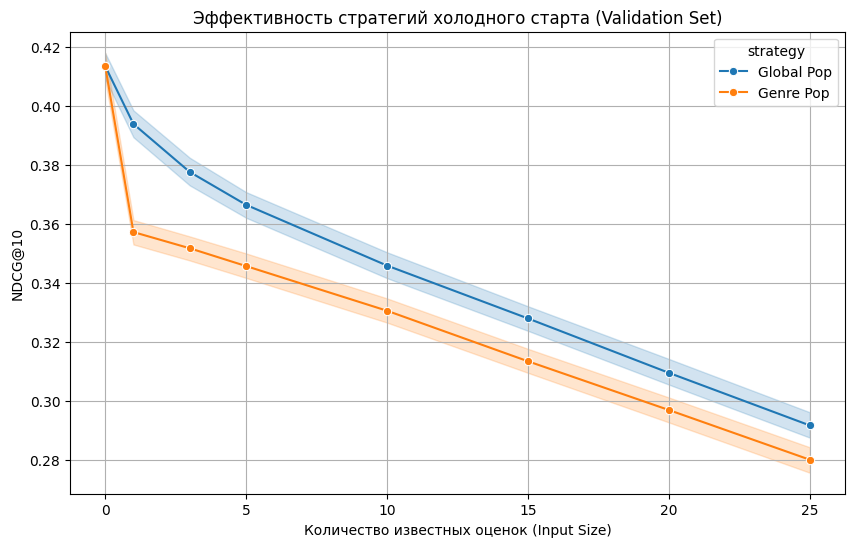

In [ ]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.lineplot(data=df_res, x='input_size', y='ndcg', hue='strategy', marker='o')
plt.title('Эффективность стратегий холодного старта (Validation Set)')
plt.ylabel('NDCG@10')
plt.xlabel('Количество известных оценок (Input Size)')
plt.grid(True)
plt.show()

### 2.3. Обучение финальной модели
Теперь, когда у нас есть лучшие гиперпараметры, мы можем обучить финальную модель на всех доступных данных (обучающая + валидационная выборки). Это позволит модели использовать больше информации и, как правило, приводит к улучшению качества.

In [ ]:
# Объединяем train и validation для обучения финальной модели
full_train_df = pd.concat([train_df, validation_df], ignore_index=True)

unique_users = full_train_df['userId'].unique()
unique_items = full_train_df['movieId'].unique()
user_to_idx = {user_id: i for i, user_id in enumerate(unique_users)}
item_to_idx = {item_id: i for i, item_id in enumerate(unique_items)}
num_users = len(user_to_idx)
num_items = len(item_to_idx)

full_train_df = map_ids(full_train_df, user_to_idx, item_to_idx)
# Создаем новую общую матрицу
full_train_matrix = csr_matrix((full_train_df['rating'],
                                (full_train_df['user_idx'].astype(int),
                                 full_train_df['item_idx'].astype(int))),
                               shape=(num_users, num_items))

print(f"Полная матрица для обучения создана. Размер: {full_train_matrix.shape}")

# Обучаем финальную модель с лучшими параметрами
final_model = AlternatingLeastSquares(**best_params_optuna, random_state=42, use_gpu=True)
final_model.fit(full_train_matrix, show_progress=True)

Полная матрица для обучения создана. Размер: (186687, 65723)


  0%|          | 0/21 [00:00<?, ?it/s]

## 3. Оценка и сохранение
### 3.1. Оценка качества на тестовой выборке
Проверим качество нашей финальной модели на отложенной тестовой выборке. Будем использовать метрики `NDCG@10` и `MAP@10`.

In [ ]:
def calculate_mean_ap(model, train_matrix, test_warm_df, k=10):
    """Рассчитывает среднее MAP@k по пользователям из тестовой выборки.

    Args:
        model: Обученная implicit модель.
        train_matrix (csr_matrix): Матрица для фильтрации уже просмотренных фильмов.
        test_warm_df (pd.DataFrame): DataFrame с "теплой" тестовой выборкой.
        k (int): Количество рекомендаций для оценки.

    Returns:
        float: Среднее значение MAP@k.
    """
    users_to_evaluate_idx = test_warm_df['user_idx'].unique()
    true_relevancy = test_warm_df[test_warm_df['rating'] >= 4.0]\
        .groupby('user_idx')['item_idx'].apply(list).to_dict()

    ap_scores = []
    for user_idx in users_to_evaluate_idx:
        recommended_items, _ = model.recommend(
            userid=user_idx, user_items=train_matrix[user_idx], N=k, filter_already_liked_items=True
        )

        relevant_items = true_relevancy.get(user_idx, [])
        if not relevant_items:
            continue

        hits, sum_precisions = 0, 0.0
        for rank, item_id in enumerate(recommended_items, start=1):
            if item_id in relevant_items:
                hits += 1
                sum_precisions += hits / rank

        ap_user = sum_precisions / min(len(relevant_items), k)
        ap_scores.append(ap_user)

    return np.mean(ap_scores) if ap_scores else 0.0

In [ ]:
# Готовим тестовую выборку
test_warm_df = test_df.dropna(subset=['user_idx', 'item_idx']).copy()
test_warm_df['user_idx'] = test_warm_df['user_idx'].astype(int)
test_warm_df['item_idx'] = test_warm_df['item_idx'].astype(int)

In [ ]:
# Считаем метрики
ndcg_test = calculate_mean_ndcg(final_model, full_train_matrix, test_warm_df, k=10)
map_test = calculate_mean_ap(final_model, full_train_matrix, test_warm_df, k=10)

print(f"NDCG@10 на тесте: {ndcg_test:.4f}")
print(f"MAP@10 на тесте: {map_test:.4f}")

NDCG@10 на тесте: 0.1401
MAP@10 на тесте: 0.0771


In [ ]:
tmp = test_warm_df.groupby('userId')['movieId'].count()
tmp_idx = tmp[tmp < 5].index

### 3.2. Сохранение артефактов
Сохраним обученную модель и словари-маппинги, чтобы можно было использовать их в дальнейшем без повторного обучения.

In [ ]:
# Создаем папку для артефактов
ARTIFACTS_DIR = "als_artifacts"
os.makedirs(ARTIFACTS_DIR, exist_ok=True)

# Сохраняем модель
final_model.save(f"{ARTIFACTS_DIR}/als_model.npz")

# Сохраняем маппинги
joblib.dump(user_to_idx, f"{ARTIFACTS_DIR}/user_to_idx.joblib")
joblib.dump(item_to_idx, f"{ARTIFACTS_DIR}/item_to_idx.joblib")

print(f"Все артефакты сохранены в папку: {ARTIFACTS_DIR}")

Все артефакты сохранены в папку: als_artifacts


In [ ]:
!zip -r als_artifacts.zip als_artifacts

  adding: als_artifacts/ (stored 0%)
  adding: als_artifacts/als_model.npz (deflated 7%)
  adding: als_artifacts/user_to_idx.joblib (deflated 72%)
  adding: als_artifacts/item_to_idx.joblib (deflated 75%)


## 4. Демонстрация работы системы
В этом разделе мы проведем расширенное тестирование нашей модели. Мы подготовим функционал для красивой визуализации постеров фильмов, загружая их с IMDB, а затем проверим качество рекомендаций на нескольких сценариях:
1.  **Существующий пользователь:** Посмотрим, что модель рекомендует реальному пользователю на основе его истории.
2.  **Холодный старт (Триллеры):** Создадим "виртуального" пользователя, любящего мрачные триллеры.
3.  **Холодный старт (Мультфильмы):** Создадим пользователя, который любит добрые мультфильмы.
4.  **Смена предпочтений:** Проверим, как модель отреагирует на негативные оценки триллерам и позитивные — мультфильмам.

In [ ]:
# --- Подготовка и загрузка артефактов ---
model = AlternatingLeastSquares().load(f"{ARTIFACTS_DIR}/als_model.npz")
user_to_idx = joblib.load(f"{ARTIFACTS_DIR}/user_to_idx.joblib")
item_to_idx = joblib.load(f"{ARTIFACTS_DIR}/item_to_idx.joblib")
idx_to_item = {idx: item_id for item_id, idx in item_to_idx.items()}
idx_to_user = {idx: user_id for user_id, idx in user_to_idx.items()}

In [ ]:
class MovieVisualizer:
    """Класс для поиска фильмов, получения постеров и визуализации."""

    def __init__(self, movies_df, links_df):
        self.movies_df = movies_df
        self.links_df = links_df
        self.movie_titles = movies_df.set_index('movieId')['title'].to_dict()
        self.headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'}

    def find_movie_id(self, title_part: str) -> int:
        """Находит ID фильма по части названия."""
        matches = self.movies_df[self.movies_df['title'].str.contains(title_part, case=False, na=False)]
        if matches.empty:
            print(f"Фильм '{title_part}' не найден.")
            return None
        # Возвращаем самый популярный (обычно первый или с меньшим ID), если несколько
        return matches.iloc[0]['movieId']

    def _get_poster_url(self, movie_id: int) -> str:
        """Парсит IMDB страницу фильма для получения ссылки на постер."""
        imdb_row = self.links_df[self.links_df['movieId'] == movie_id]
        if imdb_row.empty:
            return None

        imdb_id = str(imdb_row['imdbId'].iloc[0]).zfill(7)
        url = f"https://www.imdb.com/title/tt{imdb_id}/"

        try:
            response = requests.get(url, headers=self.headers, timeout=5)
            if response.status_code != 200: return None
            soup = BeautifulSoup(response.text, 'html.parser')
            # Ищем блок постера (IMDB классы меняются, но ipc-poster пока стабилен)
            poster_div = soup.find('div', class_='ipc-poster')
            if poster_div:
                img_tag = poster_div.find('img')
                if img_tag and img_tag.get('src'):
                    return img_tag['src']
        except Exception as e:
            pass
        return None

    def draw_posters(self, movie_ids: list, title: str = "Movies"):
        """Отрисовывает сетку постеров."""
        print(f"\n--- {title} ---")
        movies_to_draw = []

        for movie_id in movie_ids:
            clean_title = self.movie_titles.get(movie_id, "Unknown Title")
            poster_url = self._get_poster_url(movie_id)
            movies_to_draw.append({'title': clean_title, 'poster_url': poster_url})

        if not movies_to_draw:
            print("Нет фильмов для отображения.")
            return

        # Отрисовка
        num_movies = len(movies_to_draw)
        cols = 4
        rows = (num_movies + cols - 1) // cols
        fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 5.5))
        if num_movies == 1: axes = [axes]
        axes = np.array(axes).flatten()

        for i, movie in enumerate(movies_to_draw):
            ax = axes[i]
            ax.axis('off')
            display_title = movie['title'].rsplit(' (', 1)[0]
            ax.set_title(display_title, fontsize=11, wrap=True)

            if movie['poster_url']:
                try:
                    img_response = requests.get(movie['poster_url'], timeout=5)
                    img = Image.open(BytesIO(img_response.content))
                    ax.imshow(img)
                except:
                    ax.text(0.5, 0.5, 'No Image', ha='center', va='center')
            else:
                ax.text(0.5, 0.5, 'No Image', ha='center', va='center')

        for j in range(num_movies, len(axes)):
            axes[j].axis('off')
        plt.tight_layout()
        plt.show()

viz = MovieVisualizer(movies_df, links_df)

def recommend_for_existing_user(user_id_raw, model, matrix, user_map, item_map_inv, n=8):
    """Рекомендации для существующего в базе пользователя."""
    if user_id_raw not in user_map:
        print(f"Пользователь {user_id_raw} не найден.")
        return

    user_idx = user_map[user_id_raw]
    # Показываем историю (топ-8 по рейтингу)
    history_ids = full_train_df[full_train_df['userId'] == user_id_raw]\
        .sort_values('rating', ascending=False)['movieId'].head(8).tolist()
    viz.draw_posters(history_ids, title=f"История пользователя {user_id_raw} (Топ оценок)")

    # Рекомендации
    rec_indices, _ = model.recommend(user_idx, matrix[user_idx], N=n, filter_already_liked_items=True)
    rec_ids = [item_map_inv[idx] for idx in rec_indices]
    viz.draw_posters(rec_ids, title=f"Рекомендации для пользователя {user_id_raw}")


def recommend_for_new_user(movie_ratings: list, model, item_map, item_map_inv, n_items, n=8):
    """Рекомендации для холодного старта. movie_ratings: [(movie_id, rating), ...]"""
    # Строим вектор 1 x N
    rows, cols, data = [], [], []
    input_ids = []
    for mid, rating in movie_ratings:
        if mid in item_map:
            rows.append(0)
            cols.append(item_map[mid])
            data.append(rating)
            input_ids.append(mid)
        else:
            print(f"Фильм ID {mid} отсутствует в словаре модели.")

    user_vec = csr_matrix((data, (rows, cols)), shape=(1, n_items))

    # Визуализируем ввод
    viz.draw_posters(input_ids, title="Оценки нового пользователя")

    # Получаем рекомендации (recalculate_user=True)
    rec_indices, _ = model.recommend(-1, user_vec, N=n, recalculate_user=True)
    rec_ids = [item_map_inv[idx] for idx in rec_indices]
    viz.draw_posters(rec_ids, title="Персональные рекомендации (Cold Start)")

### 4.1. Сценарий 1: Существующий пользователь
Выберем случайного пользователя, который уже есть в нашей обучающей выборке. Посмотрим на его любимые фильмы (история) и на то, что модель ему предлагает.


--- История пользователя 12621 (Топ оценок) ---


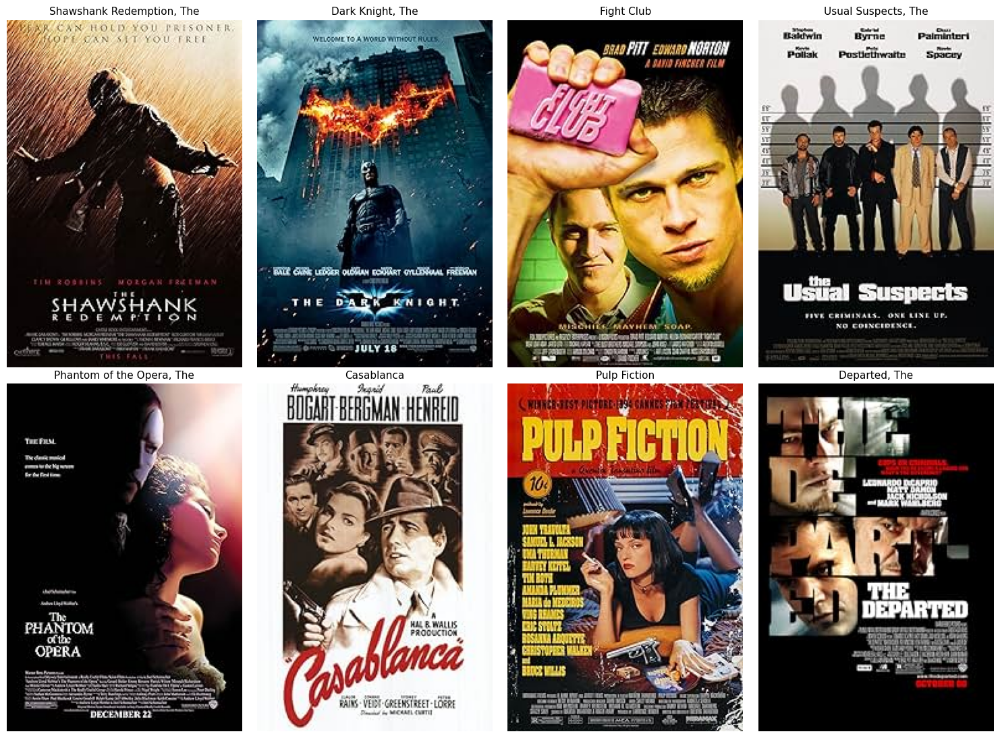


--- Рекомендации для пользователя 12621 ---


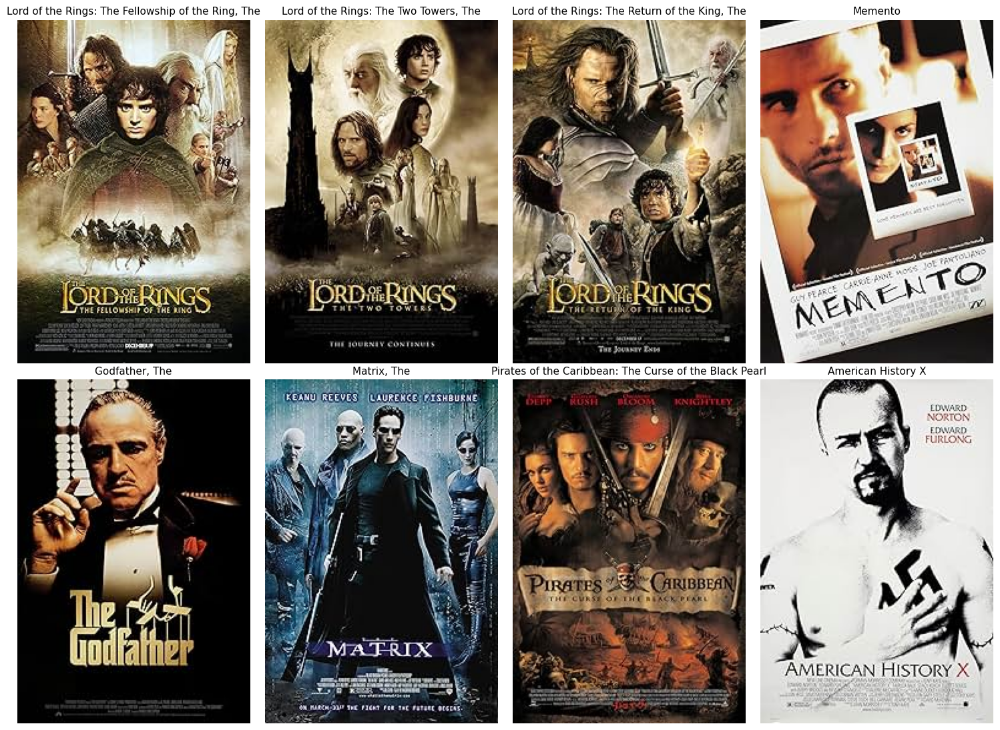

In [ ]:
random_user = full_train_df['userId'].sample(1).iloc[0]
recommend_for_existing_user(random_user, final_model, full_train_matrix, user_to_idx, idx_to_item)

### 4.2. Сценарий 2: Cold Start — Любитель Триллеров
Симулируем нового пользователя. Он высоко оценил классику мрачного кино. Ожидаем увидеть в рекомендациях похожие жанры (Crime, Drama, Thriller).


--- Оценки нового пользователя ---


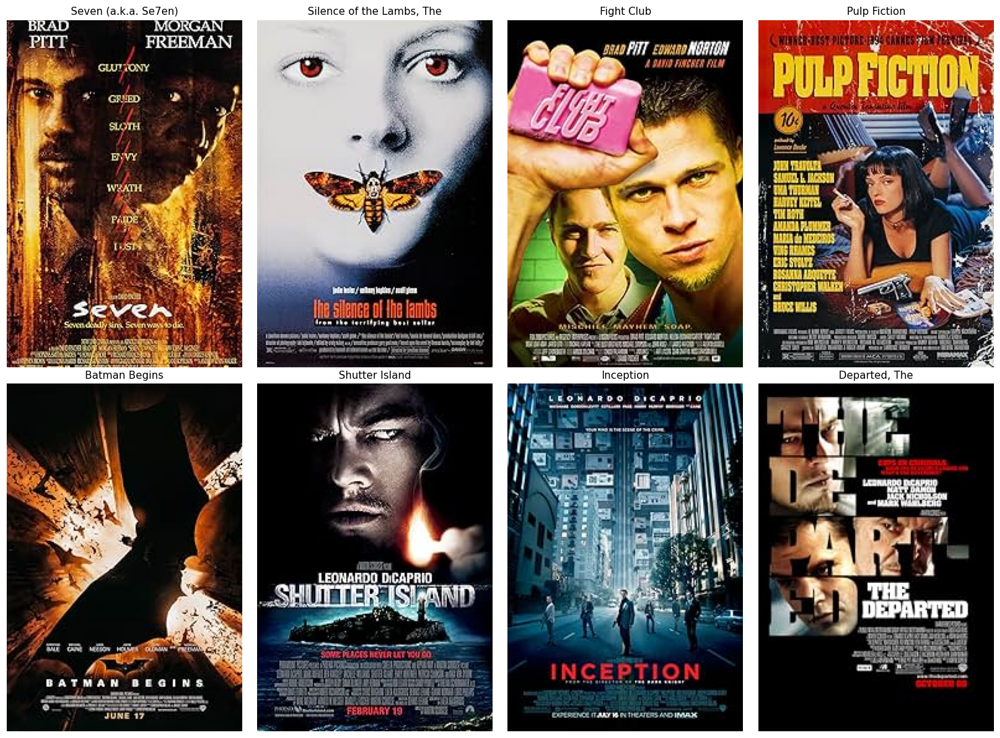


--- Персональные рекомендации (Cold Start) ---


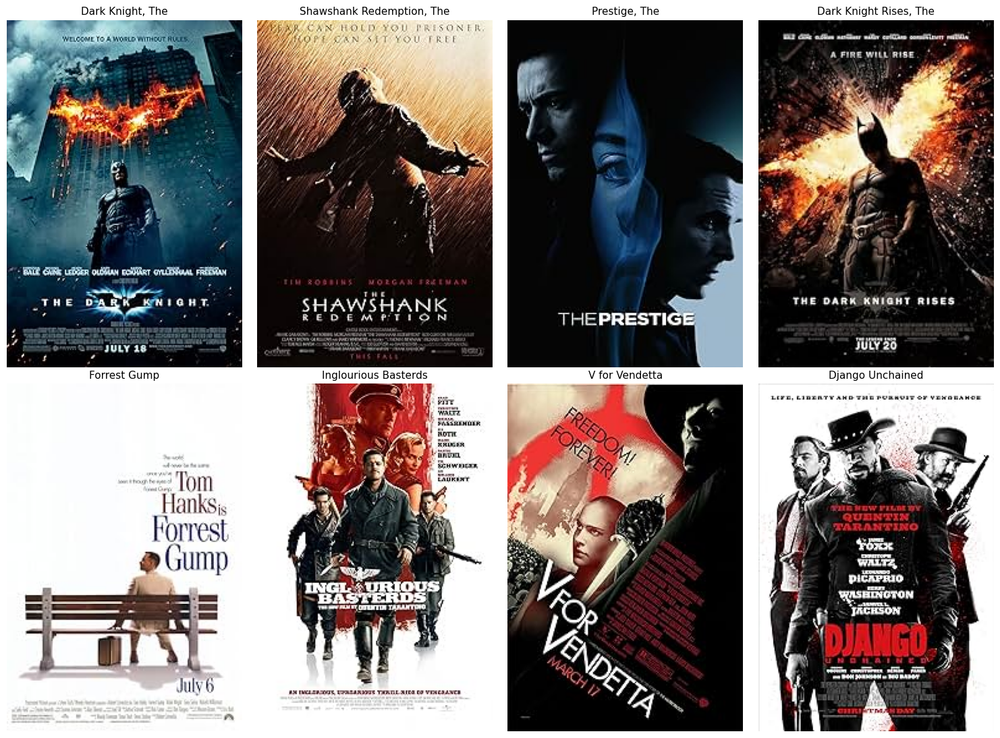

In [ ]:
thriller_fan_movies = [
    "Se7en",
    "Silence of the Lambs",
    "Fight Club",
    "Pulp Fiction",
    "Batman Begins",
    "Shutter Island",
    "Inception",
    "Departed, The"
]

# Собираем ID и ставим оценки 5.0
interactions = []
for title in thriller_fan_movies:
    mid = viz.find_movie_id(title)
    if mid:
        interactions.append((mid, 5.0))

recommend_for_new_user(interactions, final_model, item_to_idx, idx_to_item, num_items)

### 4.3. Сценарий 3: Cold Start — Любитель Мультфильмов
Теперь представим пользователя с совершенно другим вкусом. Он любит анимацию Disney и Pixar.


--- Оценки нового пользователя ---


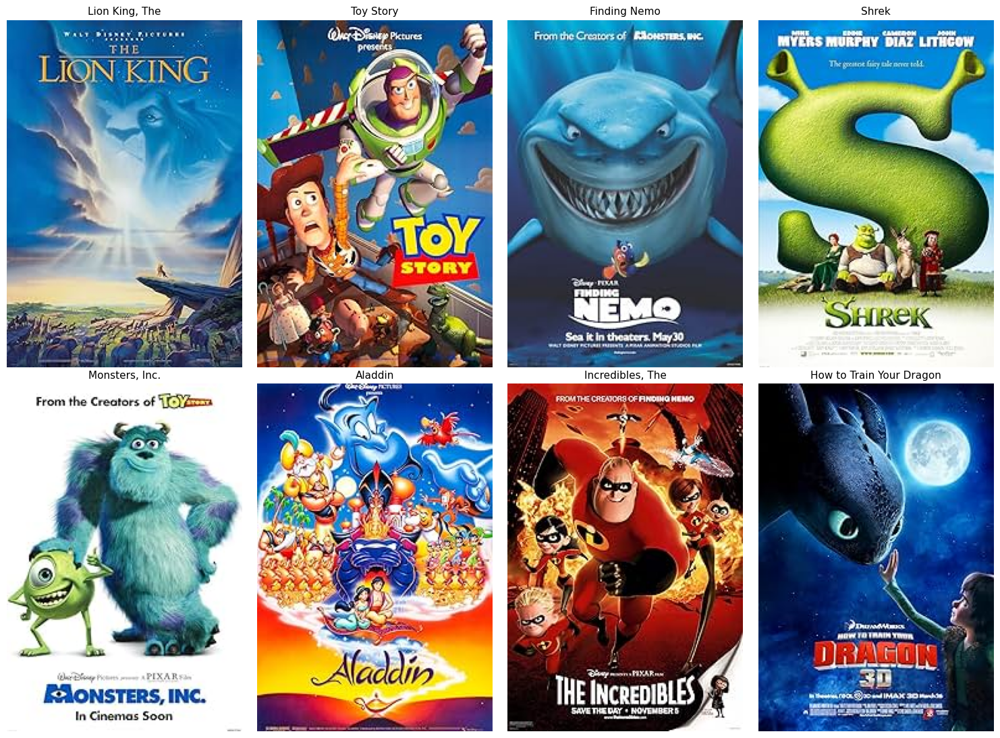


--- Персональные рекомендации (Cold Start) ---


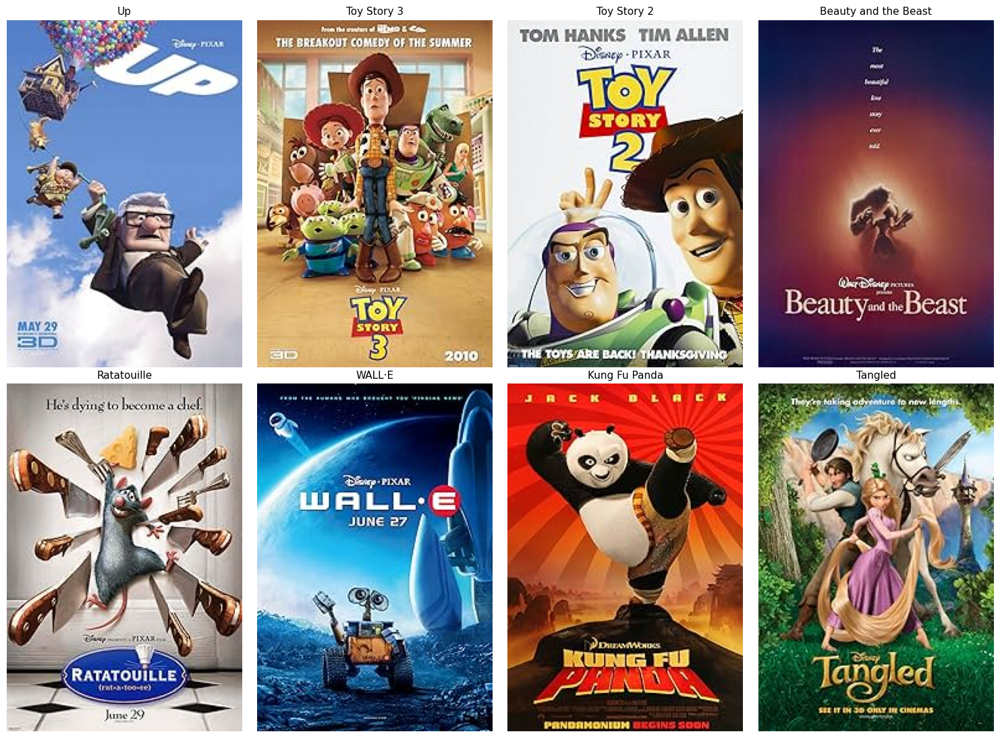

In [ ]:
cartoon_fan_movies = [
    "Lion King, The",
    "Toy Story",
    "Finding Nemo",
    "Shrek",
    "Monsters, Inc.",
    "Aladdin",
    "Incredibles, The",
    "How to train Your Dragon"
]

interactions = []
for title in cartoon_fan_movies:
    mid = viz.find_movie_id(title)
    if mid:
        interactions.append((mid, 5.0))

recommend_for_new_user(interactions, final_model, item_to_idx, idx_to_item, num_items)

### 4.4. Сценарий 4: Сложный вкус (Негативные оценки)
Самый интересный тест. Пользователь посмотрел триллеры (из Сценария 2), но они ему **не понравились** (оценка 0.5 или 1.0). Зато он в восторге от мультфильмов. Модель должна понять, что жанр "Триллер" нужно пессимизировать, несмотря на наличие факта просмотра.


--- Оценки нового пользователя ---


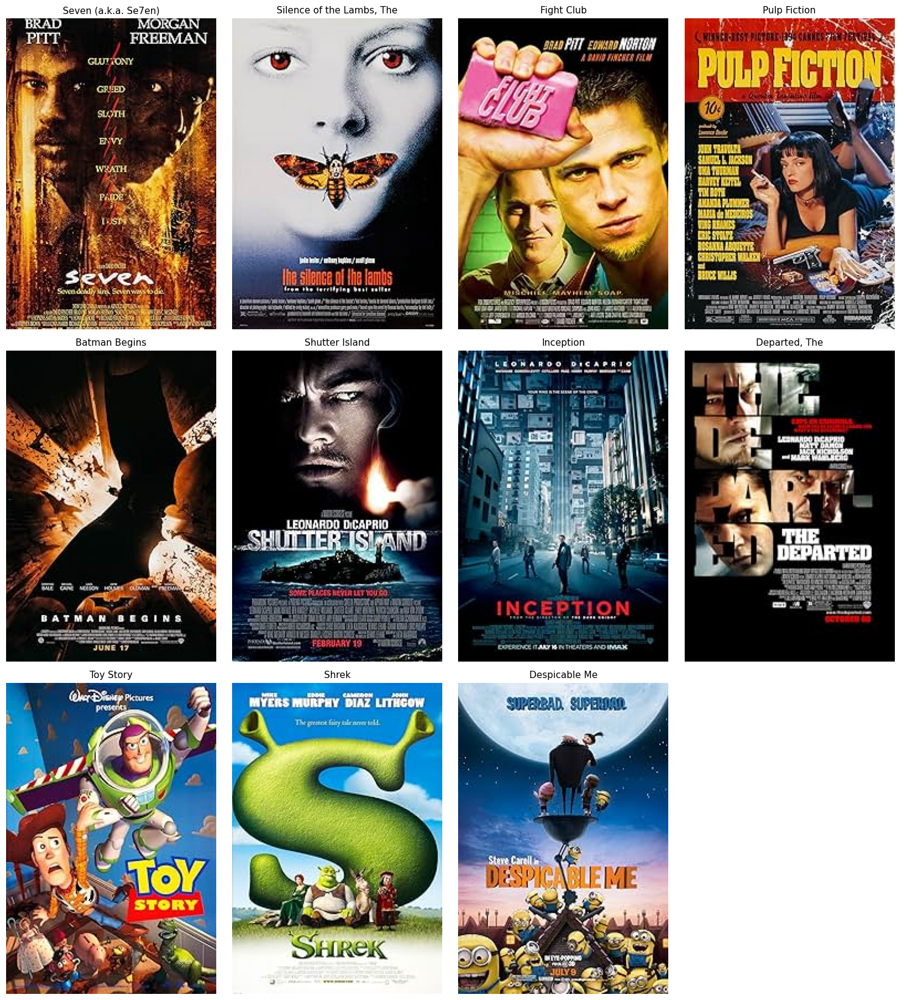


--- Персональные рекомендации (Cold Start) ---


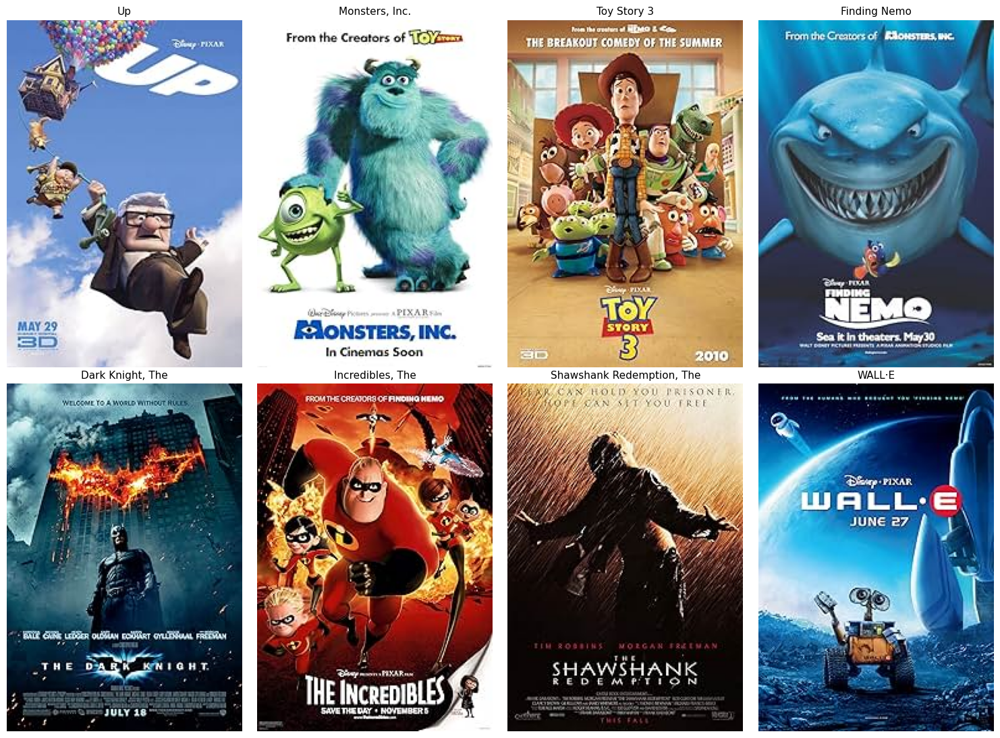

In [ ]:
mixed_interactions = []

# Ненавидит триллеры (оценка 0.5)
for title in thriller_fan_movies:
    mid = viz.find_movie_id(title)
    if mid:
        mixed_interactions.append((mid, 0.5))

# Обожает мультики (оценка 5.0)
for title in ["Toy Story", "Shrek", "Despicable Me"]:
    mid = viz.find_movie_id(title)
    if mid:
        mixed_interactions.append((mid, 5.0))

recommend_for_new_user(mixed_interactions, final_model, item_to_idx, idx_to_item, num_items)